# 1 - Уменьшение палитры изображения
Для <a href='https://thumbs.dreamstime.com/x/two-lorikeet-birds-2293918.jpg'> картинки </a> нужно уменьшить число цветов в палитре.

Для этого нужно выделить **кластеры в пространстве RGB**, объекты соответствуют пикселям изображения. После выделения кластеров, все пиксели, отнесенные в один кластер, заполняются одним цветом; этот цвет может быть центроидом соответствующего кластера, медианным цветом по кластеру.

Попробуйте различные алгоритмы кластеризации:

* KMeans
* DBSCAN
* AgglomerativeClustering

Рассмотрите число кластеров K = 2, 3, 10, 20 (в алгоритмах, где есть такой гиперпараметр).

Для различных кластеризаций оцените и сравните потери от уменьшения цветов при помощи метрики
<a href='http://scikit-image.org/docs/dev/api/skimage.measure.html#skimage.measure.compare_ssim'> SSIM </a>. Какой способ оказался лучшим?

Задание оценивает в 5 баллов.
Задание можно выполнять на своих картинках

Пару пояснений к тому, что будет ниже: я использовал для уменьшения палитры цветов три алгоритма, перечисленных выше. Каждый алгоритм можно найти в соответсвующей секции (см. содержание).

Также для отрисовки всевозможных графиков было написано довольно много строчек кода, поэтому их советую не проверять (если только конечно к результатам работы этого кода нет вопросов); для этого эти ячейки я сделал в виде формы.

In [ ]:
# from tqdm import tqdm
from tqdm.auto import trange, tqdm

import random
import numpy as np
import pandas as pd
from skimage.metrics import structural_similarity

import warnings
warnings.filterwarnings('ignore')

np.random.seed(42)

In [ ]:
!pip3 install opencv-python

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import matplotlib.pyplot as plt
import cv2 # нужно поставить себе cv2 через conda install opencv

def draw_picture(image, bgr=False):
    # так как: https://docs.opencv.org/4.x/d4/da8/group__imgcodecs.html#ga288b8b3da0892bd651fce07b3bbd3a56
    b, g, r = cv2.split(image) # по умолчанию cv2 почему-то отдает цвета в порядке BGR вместо RGB
    new_image = cv2.merge([r, g, b])
    # plt.figure(figsize=(7, 5))
    plt.axis('off')
    plt.imshow(new_image)
    # plt.show()

img - это обычный трехмерный массив цветов пикселей, где две первые координаты - это координаты каждого пикселя, и третья обозначает R, G или B.

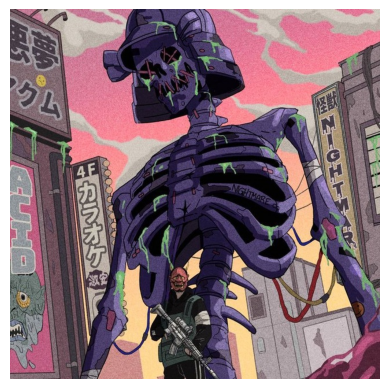

In [ ]:
img = cv2.imread('sk.jpg') # считать картинку
draw_picture(img) # нарисовать картинку

In [ ]:
img.shape # сам img - это обычный трехмерный массив 640 x 640 x 3
# вам скорее все кстати понадобится сделать reshape, чтобы перейти от 275x400 к одномерному массиву пикселей

(640, 640, 3)

In [ ]:
X = img.reshape((-1,3)).astype(np.float32) # столбцы это b, g, r компоненты (именно в таком порядке)

## Пример работы алгоритма из sklearn для `k = 5`

In [ ]:
from sklearn.cluster import KMeans


k = 5
kmeans = KMeans(n_clusters=k, random_state=123).fit(X)
center = kmeans.cluster_centers_

In [ ]:
kmeans.cluster_centers_  # centers of our clasters (blue dots in graph below)

array([[ 88.12485 ,  67.71889 ,  84.1542  ],
       [170.8519  , 187.71606 , 208.53871 ],
       [ 34.68065 ,  18.932762,  26.228195],
       [148.35913 , 128.92021 , 228.58334 ],
       [133.91656 , 127.59345 , 141.13365 ]], dtype=float32)

In [ ]:
X_and_labels = np.concatenate((X, kmeans.labels_.reshape(-1, 1)), axis=1)
X_and_labels

array([[ 75.,  69.,  86.,   0.],
       [ 95.,  89., 106.,   0.],
       [ 97.,  90., 111.,   0.],
       ...,
       [ 58.,  41.,  85.,   0.],
       [ 54.,  37.,  81.,   0.],
       [ 51.,  34.,  78.,   0.]])

Ниже для лушего понимания представлено разбиение на классы (k=5) для матрицы $X$. на 3D графике (а также цвета, в которые при этом окрашиваются точки).

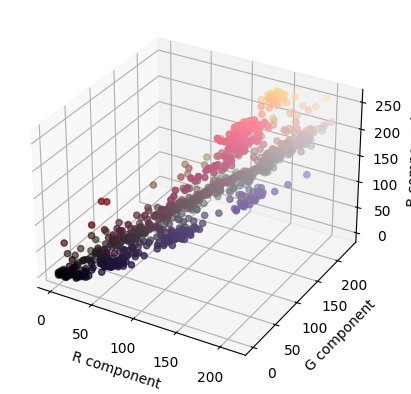

In [ ]:
#@title The 3D noninteractive graph: Распределение выборки цветов
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np


n = 1000
# Take some random dots data from X
A = X_and_labels[np.random.randint(X_and_labels.shape[0], size=n), :]
x = A[:, 0]
y = A[:, 1]
z = A[:, 2]

# get centers of the clasters
x_m = center[:, 0]
y_m = center[:, 1]
z_m = center[:, 2]

# Create a 3D figure
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Plot the data as dots, with colors based on the labels
ax.scatter(x, y, z, marker='o', facecolor=A[:, [2, 1, 0]] / 255)
# ax.scatter(x, y, z, marker='o', facecolor=cc)
# ax.scatter(x_m, y_m, z_m, marker='o', color='blue', s=50)

# Set the labels for the x, y and z axes
ax.set_xlabel('R component')
ax.set_ylabel('G component')
ax.set_zlabel('B component')

# Show the plot
plt.show()


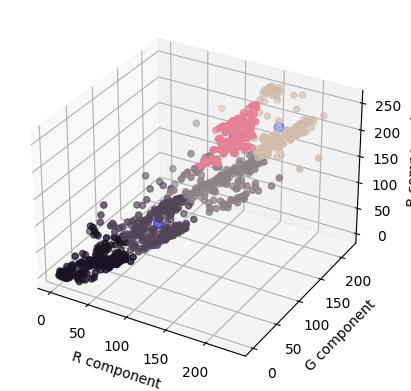

In [ ]:
#@title The 3D noninteractive graph: Цветовая палитра кластеров
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np

# Take some random dots data from X
A = X_and_labels[np.random.randint(X_and_labels.shape[0], size=1000), :]
x = A[:, 0]
y = A[:, 1]
z = A[:, 2]

# get centers' colors of the clasters
d = {0: center[0], 1: center[1], 2: center[2], 3: center[3], 4: center[4]}
def f(x):
    return d[x][::-1] / 255

cc = np.array(list(map(f, A[:,-1])))

# get centers of the clasters
x_m = center[:, 0]
y_m = center[:, 1]
z_m = center[:, 2]

# Create a 3D figure
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Plot the data as dots, with colors based on the labels
ax.scatter(x, y, z, facecolor=cc, marker='o')
ax.scatter(x_m, y_m, z_m, marker='o', color='blue', s=50)

# Set the labels for the x, y and z axes
ax.set_xlabel('R component')
ax.set_ylabel('G component')
ax.set_zlabel('B component')

# Show the plot
plt.show()


In [ ]:
#@title The 3D interactive graph: Распределение выборки цветов
# Try to plot the dots from matrix X, where
# the first column is the flatten r vector (component R of RGB image),
# the second - g, the third - b; so the demension of our space is equal 3 (features)

# my TODO:  make each dot with its particular color (first trace) and clusters paint in colors of theirs centroids (trace2)
# for this: https://stackoverflow.com/questions/52788407/how-to-plot-graphics-with-the-colors-of-each-pixel-in-the-image


import plotly.graph_objs as go
import numpy as np


#@markdown ### Количество случайных пикселей для отрисовки на графике (должно быть меньше `X.shape`)
n = 1000 #@param {type:"integer"}
if n > X.shape[0]:
    raise ValueError('n should be less than X.shape[0]\n Ну я же просил...')

# Take some random dots data from X
A = X_and_labels[np.random.randint(X_and_labels.shape[0], size=n), :]
x = A[:, 0]
y = A[:, 1]
z = A[:, 2]

# Create a trace for the scatter plot
# trace1 = go.Scatter3d(x=x, y=y, z=z, mode='markers', marker=dict(size=5, color=A[:, -1]))
trace1 = go.Scatter3d(x=x, y=y, z=z, mode='markers', marker=dict(size=5, color=A[:, [2, 1, 0]] / 255))

x_m = center[:, 0]
y_m = center[:, 1]
z_m = center[:, 2]

# trace2 = go.Scatter3d(x=x_m, y=y_m, z=z_m, mode='markers', marker=dict(size=5, color='red'))

# Create a layout for the plot
layout = go.Layout(scene=dict(xaxis=dict(title='R component'),
                               yaxis=dict(title='G component'),
                               zaxis=dict(title='B component')))

# Combine the trace and layout into a figure
fig = go.Figure(data=[trace1], layout=layout)

# Display the plot
fig.show()


In [ ]:
#@title The 3D interactive graph: Цветовая палитра кластеров
# Try to plot the dots from matrix X, where
# the first column is the flatten r vector (component R of RGB image),
# the second - g, the third - b; so the demension of our space is equal 3 (features)

# TODO:  make each dot with its particular color (first trace) and clusters paint in colors of theirs centroids (trace2)
# for this: https://stackoverflow.com/questions/52788407/how-to-plot-graphics-with-the-colors-of-each-pixel-in-the-image


import plotly.graph_objs as go
import numpy as np

#@markdown ### Количество случайных пикселей для отрисовки на графике (должно быть меньше `X.shape`)
n = 1000 #@param {type:"integer"}
if n > X.shape[0]:
    raise ValueError('n should be less than X.shape[0]\n Ну я же просил...')

# Take some random dots data from X
A = X_and_labels[np.random.randint(X_and_labels.shape[0], size=n), :]
x = A[:, 0]
y = A[:, 1]
z = A[:, 2]

# get centers' colors of the clasters
d = {0: center[0], 1: center[1], 2: center[2], 3: center[3], 4: center[4]}
def f(x):
    return d[x][::-1] / 255

cc = np.array(list(map(f, A[:,-1])))

# Create a trace for the scatter plot
trace1 = go.Scatter3d(x=x, y=y, z=z, mode='markers', marker=dict(size=5, color=cc))

x_m = center[:, 0]
y_m = center[:, 1]
z_m = center[:, 2]

trace2 = go.Scatter3d(x=x_m, y=y_m, z=z_m, mode='markers', marker=dict(size=5, color='red'))

# Create a layout for the plot
layout = go.Layout(scene=dict(xaxis=dict(title='R component'),
                               yaxis=dict(title='G component'),
                               zaxis=dict(title='B component')))

# Combine the trace and layout into a figure
fig = go.Figure(data=[trace1, trace2], layout=layout)

# Display the plot
fig.show()


In [ ]:
center = np.uint8(center)
center.shape

(5, 3)

In [ ]:
center

array([[ 88,  67,  84],
       [170, 187, 208],
       [ 34,  18,  26],
       [148, 128, 228],
       [133, 127, 141]], dtype=uint8)

In [ ]:
label = kmeans.labels_
res = center[label.flatten()]

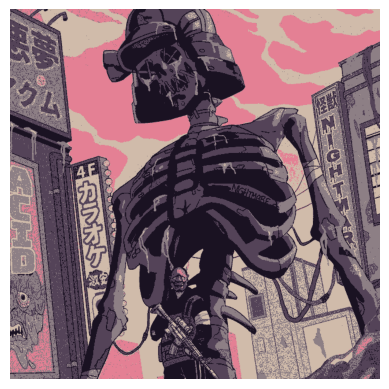

In [ ]:
# example for k = 5
result_image = res.reshape((img.shape))
draw_picture(result_image)

## Перебор гиперпараметров для KMeans из sklearn

In [ ]:
K_s = np.arange(2, 25, 1)

result_images = {}
inertia = {}
for i, K in tqdm(enumerate(K_s)):
    kmeans = KMeans(n_clusters=K, random_state=123).fit(X)

    center = np.uint8(kmeans.cluster_centers_)
    res = center[kmeans.labels_.flatten()]
    result_image = res.reshape((img.shape))

    result_images[K] = result_image
    inertia[K] = kmeans.inertia_

23it [03:26,  8.98s/it]


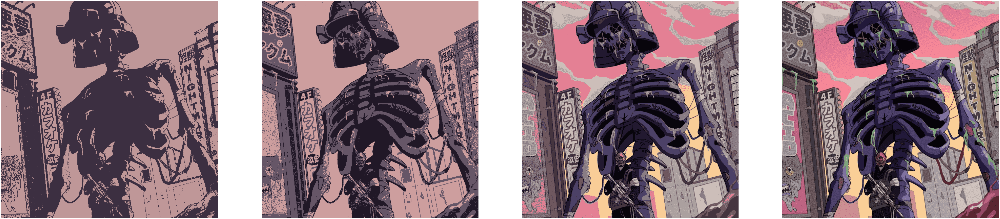

In [ ]:
# для отрисовки некоторых картинок из списка result_images:

fig = plt.figure(figsize=(90, 125))

Ks_to_show = [2, 3, 10, 24]
for i, k in enumerate(Ks_to_show):
    res_img = result_images[k]
    ax = fig.add_subplot(1, len(Ks_to_show), i + 1)
    draw_picture(res_img)

plt.show()

Оценим теперь различия картинок (реальной и с уменьшенным количеством цветов) с помощью метрики [SSIM](https://en.wikipedia.org/wiki/Structural_similarity) для метода k-средних из под sklearn.

https://cvnote.ddlee.cc/2019/09/12/psnr-ssim-python

In [ ]:
ssim_metrics = []

for result_image in result_images.values():
    ssim = structural_similarity(img, result_image, multichannel=True)
    ssim_metrics.append(ssim)

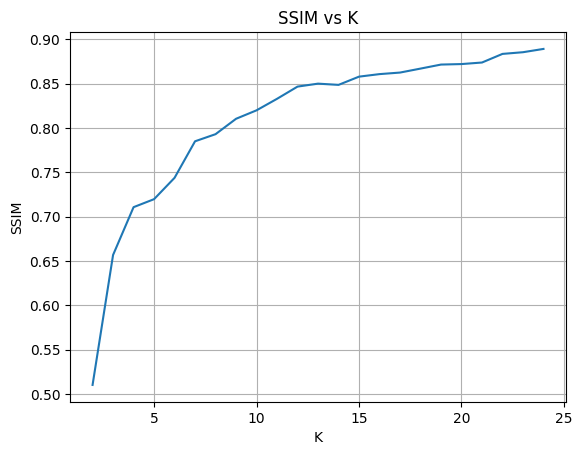

In [ ]:
plt.plot(K_s, ssim_metrics)
plt.grid()
plt.xlabel('K')
plt.ylabel('SSIM')
plt.title('SSIM vs K')
plt.show()

Из графика получаем, что чем выше значение метрики SSIM, тем ниже искажения изображения и выше качество.

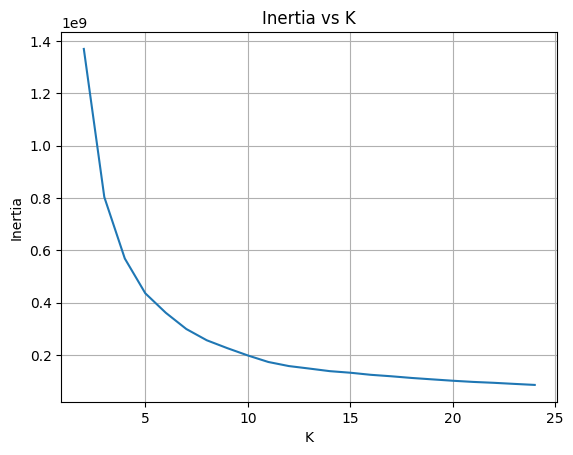

In [ ]:
# Ради интереса реализуем метод локтя для определения оптимального (с точки зрения данного метода) количества кластеров

plt.plot(K_s, inertia.values())
plt.grid()
plt.xlabel('K')
plt.ylabel('Inertia')
plt.title('Inertia vs K')
plt.show()

# так как у нас есть возможность перебрать много вариантов для количества кластеров, то график получается довольно гладким,
# поэтому лучше использовать другую метрику (т.е. в данном случае SSIM, так как мы работаем с изображениями)
# для определения оптимального количества кластеров.

# 2 - Пишем K-Means сами

Написать K-Means и сравнить с моделькой из под sklearn.

Задание оценивается в 5 баллов

In [ ]:
class My_KMeans:
    def __init__(self, n_clusters: int = 5, max_iter: int = 100, tol: float = 1e-4):
        self.n_clusters = n_clusters
        self.max_iter = max_iter
        self.tol = tol


    def fit(self, X):
        self.centroids = {}

        # Initialization of centroids with random points from the dataset
        for i in range(self.n_clusters):
            self.centroids[i] = X[random.randint(0, len(X)-1)]

        # Calculate the distances between all pairs of points in advance
        dist_matrix = np.zeros((len(X), self.n_clusters))
        for j in range(self.n_clusters):
            dist_matrix[:, j] = np.sum((X - self.centroids[j])**2, axis=1)

        # The main cycle of the algorithm
        for _ in range(self.max_iter):
            self.classes = {}
            for i in range(self.n_clusters):
                self.classes[i] = []

            # We find only points that have changed their affiliation
            if len(self.classes[0]) > 0:
                for c in range(self.n_clusters):
                    X_c = np.array(self.classes[c])
                    dist_matrix[self.classes[c], c] = np.sum((X_c - self.centroids[c])**2, axis=1)

            # Calculating which cluster each point belongs to
            classifications = np.argmin(dist_matrix, axis=1)
            for i, c in enumerate(classifications):
                self.classes[c].append(X[i])

            prev_centroids = dict(self.centroids)

            # Updating centroids
            for c in range(self.n_clusters):
                if len(self.classes[c]) > 0:
                    self.centroids[c] = np.mean(self.classes[c], axis=0)

            # Checking for convergence of the algorithm
            is_converged = True
            for centroid in self.centroids:
                original_centroid = prev_centroids[centroid]
                curr_centroid = self.centroids[centroid]
                if np.sum((curr_centroid - original_centroid) / original_centroid * 100.0) > self.tol:
                    is_converged = False

            # If the centroids have not changed, then exit the loop
            if is_converged:
                break

        # Calculate the sum of squared distances within each cluster
        self.inertia_ = 0
        for c in range(self.n_clusters):
            X_c = np.array(self.classes[c])
            if len(X_c) > 0:
                dist = np.sum((X_c - self.centroids[c])**2)
                self.inertia_ += dist

        # Predicting cluster labels for all points
        labels = []
        for i, x in enumerate(X):
            distances = np.sum((x - np.array(list(self.centroids.values())))**2, axis=1)
            label = np.argmin(distances)
            labels.append(label)

        self.labels_ = np.array(labels)

        return self

    def predict(self, X):
        distances = [np.linalg.norm(X - self.centroids[centroid]) for centroid in self.centroids]
        classification = distances.index(min(distances))
        return classification

## Перебор гиперпараметров для My_KMeans

In [ ]:
my_res_imgs = {}
my_inertia = {}

for i, K in tqdm(enumerate(K_s)):
    kmeans = My_KMeans(n_clusters=K).fit(X)

    center = np.uint8(np.array(list(kmeans.centroids.values())))
    res = center[kmeans.labels_.flatten()]
    result_image = res.reshape((img.shape))

    my_res_imgs[K] = result_image
    my_inertia[K] = kmeans.inertia_

23it [03:16,  8.53s/it]


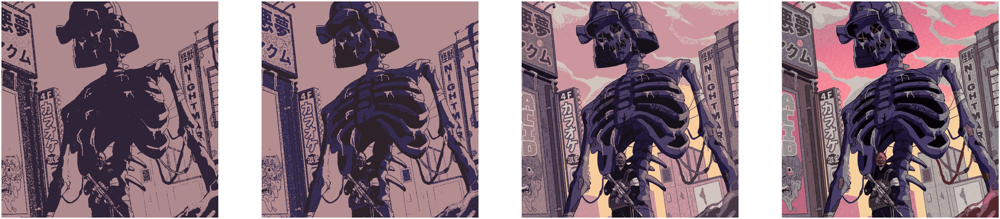

In [ ]:
# для отрисовки некоторых картинок из списка my_res_imgs:

fig = plt.figure(figsize=(90, 125))

Ks_to_show = [2, 3, 10, 24]
for i, k in enumerate(Ks_to_show):
    res_img = my_res_imgs[k]
    ax = fig.add_subplot(1, len(Ks_to_show), i + 1)
    draw_picture(res_img)

plt.show()

Видно, что результат оказался таким же как и при использовании встроенного алгоритма. Визуально видны различия между картинаками для разного количества кластеров (например, между двумя последними: на последней появился зелёный цвет).

Попробуем оценить различие цветов также с помощью метрики SSIM.

In [ ]:
my_ssim_metrics = []

for result_image in my_res_imgs.values():
    ssim = structural_similarity(img, result_image, multichannel=True)
    my_ssim_metrics.append(ssim)

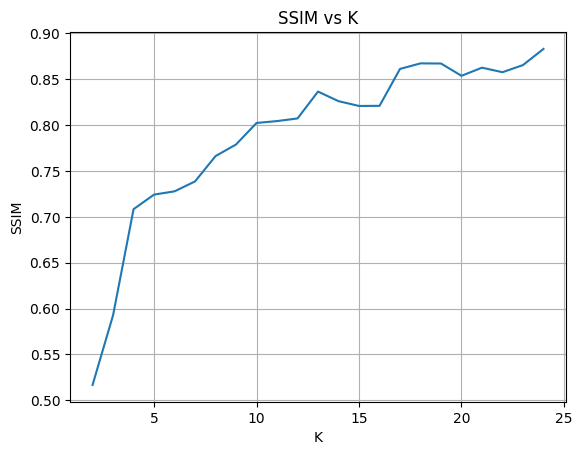

In [ ]:
plt.plot(K_s, my_ssim_metrics)
plt.grid()
plt.xlabel('K')
plt.ylabel('SSIM')
plt.title('SSIM vs K')
plt.show()

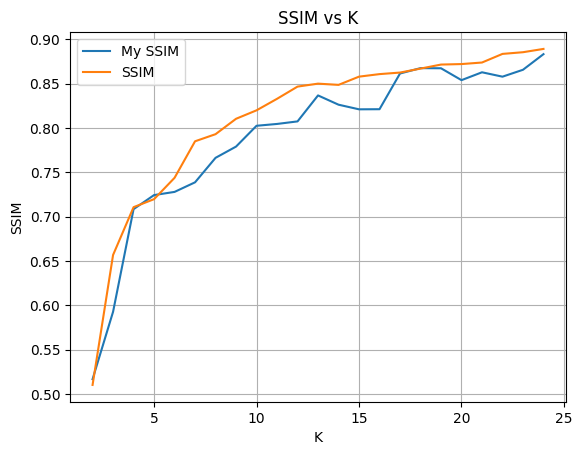

In [ ]:
# Два графика одновременно

plt.plot(K_s, my_ssim_metrics, label='My SSIM')
plt.plot(K_s, ssim_metrics, label='SSIM')

plt.grid()
plt.xlabel('K')
plt.ylabel('SSIM')
plt.title('SSIM vs K')
plt.legend()
plt.show()

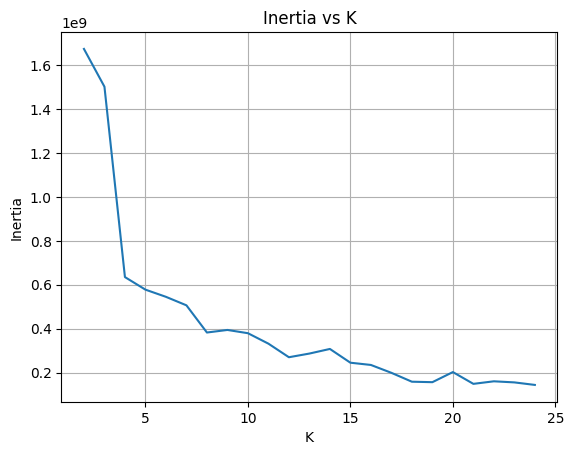

In [ ]:
# Mетод локтя для определения оптимального (с точки зрения данного метода) количества кластеров

plt.plot(K_s, my_inertia.values())
plt.grid()
plt.xlabel('K')
plt.ylabel('Inertia')
plt.title('Inertia vs K')
plt.show()

# так как это был самописный алгоритм, то тут уже график не такой гладкий и
# если смотреть на него, то оптимльным K будет от 10 до 15 (но опять же все зависит от тако какую точность мы хотим получить)

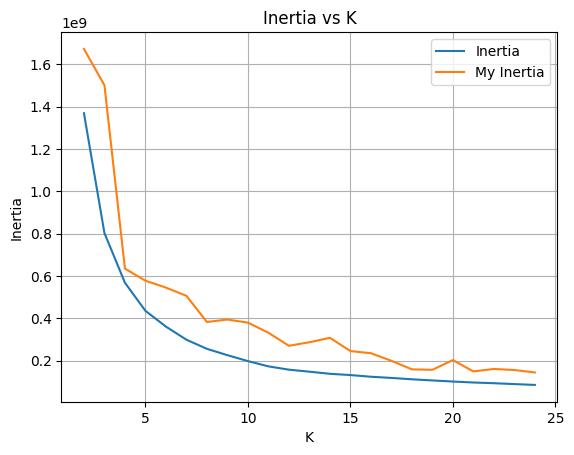

In [ ]:
# Два графика одновременно

plt.plot(K_s, inertia.values(), label='Inertia')
plt.plot(K_s, my_inertia.values(), label='My Inertia')
plt.grid()
plt.xlabel('K')
plt.ylabel('Inertia')
plt.title('Inertia vs K')
plt.legend()
plt.show()

# и даже тут собственная реализация хуже...(

Видно, что мой класс справился хуже, если смотреть на метрику SSIM. Это может быть связано с несколькими случаями: во-первых, центроиды в самом начале выбираются случайно (в реализованном мною классе) это не всегда хорошо (вместо этого можно использовать медот KMeans++); во-вторых, могут быть использованы разные эвристики и алгоритмы (например, по умолчанию в sklearn используется алгоритм lloyd) для улучшения точности результата (что не реализовано у меня в классе). Также заметны некотрые проседания метрики для разных $K$ (скорее всего это связано со случайной реализацией начальных центров кластеров).

# 3 - Пишем DBSCAN сами (дополнительное задание на 5 баллов)

Аналогично предыдудщему заданию

In [ ]:
from collections import defaultdict

In [ ]:
class My_DBSCAN:
    def __init__(self, eps=0.5, min_samples=5, show_pbar=False):
        self.eps = eps
        self.min_samples = min_samples
        self.show_pbar = show_pbar
        self.labels_ = None
        self.visited = set()
        self.clusters = [] # doesn't include noise points

    def fit(self, X):
        """
        Go through each point of the input data X. If a point has not been visited before,
        we find all its neighbors within a given "eps" radius using the "region_query" method.
        If the number of neighbors is less than "min_samples", then we mark this point as noise,
        otherwise we expand the cluster using the "expand_cluster" method.
        """

        self.labels_ = np.full(X.shape[0], -1)

        for i in tqdm(range(X.shape[0]), desc='DBSCAN', leave=self.show_pbar):
            if i in self.visited:
                continue
            self.visited.add(i)

            neighbors = self.region_query(X, i)
            if len(neighbors) < self.min_samples:
                self.labels_[i] = -1
            else:
                self.expand_cluster(X, i, neighbors)
        return self

    def expand_cluster(self, X, i, neighbors):
        """
        Adding a point to the cluster and looking for all its neighbors.
        If the number of neighbors is greater than or equal to "min_samples",
        we add them to the cluster and continue the search. If a point has
        not yet been assigned to any cluster, we mark it as a member
        of this cluster.
        """

        self.labels_[i] = len(self.clusters)
        cluster = [i]
        while len(neighbors) > 0:
            j = neighbors.pop()

            if j not in self.visited:
                self.visited.add(j)

                new_neighbors = self.region_query(X, j)
                if len(new_neighbors) >= self.min_samples:
                    neighbors = list(np.union1d(neighbors, new_neighbors))

            if self.labels_[j] == -1:
                self.labels_[j] = len(self.clusters)
                cluster.append(j)
        self.clusters.append(cluster)

    def region_query(self, X, i):
        """
        Take point i and returns the indexes of all points
        within the eps radius of point i.
        """
        return list(np.where(np.sum((X[i] - X)**2, axis=1) < self.eps**2)[0])

Сам алгоритм работает, но запускать его на данной картинке слишком дорого (так как он должен пройтись по каждому из 409000 пикселей). Поэтому попробуем сжать исходную картинку (из масссива уберем каждый третий пиксель).

P.S. Если есть возможность прогнать это на более мощном железе, то просто нужно определить `img_cut = img` в ячейке ниже.

In [ ]:
img_cut = img[::4, ::4]
img_cut.shape

(160, 160, 3)

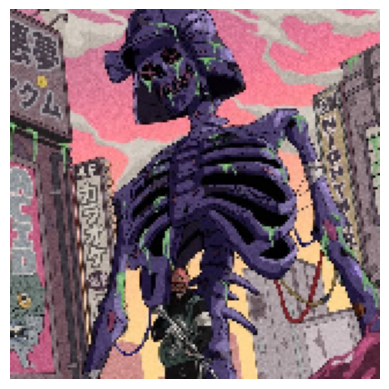

In [ ]:
draw_picture(img_cut)
# визуально картинка стала более шакального качества

In [ ]:
X_cut = img_cut.reshape((-1,3)).astype(np.int32) # столбцы это b, g, r компоненты (именно в таком порядке)
X_cut.shape

(25600, 3)

## Пример работы алгоритма для `eps = 4`, `min_samples = 15`

In [ ]:
dbscan = My_DBSCAN(eps=4, min_samples=15).fit(X_cut)

DBSCAN:   0%|          | 0/25600 [00:00<?, ?it/s]

In [ ]:
np.unique(dbscan.labels_, return_counts=True) # count of clusters within noise

# видно, что при данных гиперпараметрах достаточно много шумовых точек,
# причем количество точек в некоторых кластерах очень мало, а в некоторых наоборот.

(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10]),
 array([ 5198, 15850,  2819,   386,   173,   169,    37,    21,    15,
          121,   795,    16]))

In [ ]:
X_cut_and_labels = np.concatenate((X_cut, dbscan.labels_.reshape(-1, 1)), axis=1)

In [ ]:
df_xl = pd.DataFrame(X_cut_and_labels, columns=['b', 'g', 'r', 'label'])
cls_stats = df_xl.groupby('label').agg(['mean', 'median'])
cls_stats.head()

b                  g                  r       
             mean median        mean median        mean median
label                                                         
-1     115.894575  124.0  115.209696  121.0  143.454790  137.0
 0      95.522587   95.0   81.825174   67.0   92.702334   79.0
 1     148.543100  149.0  124.982973  127.0  232.132316  237.0
 2     159.854922  160.0  111.816062  111.5  125.914508  125.0
 3     120.271676  121.0  123.676301  124.0  111.901734  112.0

Попробуем для данного набора гиперпараметров построить график как и выше, только в первом случае будем вычислять цвет точек в кластере как их медиана, а во втором - как среднее.

Белым цветом будем обозначать шум.

In [ ]:
def get_colors(label, cls_stats_):
    x = label[0]
    if x == -1:
        return np.array([1, 1, 1]), np.array([1, 1, 1])

    r_mean, r_median = cls_stats_.loc[x].loc['r'] / 255
    b_mean, b_median = cls_stats_.loc[x].loc['b'] / 255
    g_mean, g_median = cls_stats_.loc[x].loc['g'] / 255

    return np.array([b_mean, g_mean, r_mean]), np.array([b_median, g_median, r_median])

In [ ]:
#@title The 3D interactive graph: Цветовая палитра кластеров (для средних)
# Try to plot the dots from matrix X, where
# the third column is the flatten r vector (component R of RGB image),
# the second - g, the first one - b; so the demension of our space is equal 3 (features)

# TODO:  Paint clusters in colors of theirs mean/median values
# for this: https://stackoverflow.com/questions/52788407/how-to-plot-graphics-with-the-colors-of-each-pixel-in-the-image


import plotly.graph_objs as go
import numpy as np

np.random.seed(42)
# n=10000

#@markdown ### Количество случайных пикселей, взятых из шакального изображения для отрисовки на графике (должно быть меньше `X_cut.shape`)
n = 1000 #@param {type:"integer"}
if n > X_cut.shape[0]:
    raise ValueError('n should be less than X_cut.shape[0]\n Ну я же просил...')

# Take some random dots data from X
A = X_cut_and_labels[np.random.randint(X_cut_and_labels.shape[0], size=n), :]
b = A[:, 0]
g = A[:, 1]
r = A[:, 2]

# Get colors
cc_mm = np.apply_along_axis(get_colors, 1, A[:,-1].reshape(-1, 1), cls_stats)

cc_mean = cc_mm[:, 0][:, [2, 1, 0]]
cc_median = cc_mm[:, 1][:, [2, 1, 0]]

# Create a trace for the scatter plot
trace1 = go.Scatter3d(x=r, y=g, z=b, mode='markers', marker=dict(size=5, color=cc_mean))

# Create a layout for the plot
layout = go.Layout(scene=dict(xaxis=dict(title='R component'),
                               yaxis=dict(title='G component'),
                               zaxis=dict(title='B component')))

# Combine the trace and layout into a figure
fig = go.Figure(data=[trace1], layout=layout)

# Display the plot
fig.show()


In [ ]:
cc_mm_ = np.apply_along_axis(get_colors, 1, X_cut_and_labels[:,-1].reshape(-1, 1), cls_stats)

colors_mean = cc_mm_[:, 0]
colors_median = cc_mm_[:, 1]

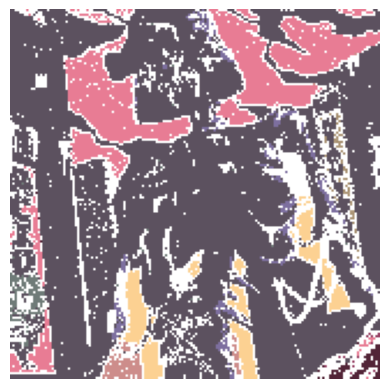

In [ ]:
img_cut_cls_mean = colors_mean.reshape((img_cut.shape))
draw_picture(img_cut_cls_mean)

In [ ]:
#@title The 3D interactive graph: Цветовая палитра кластеров (для медиан)
# Try to plot the dots from matrix X, where
# the third column is the flatten r vector (component R of RGB image),
# the second - g, the first one - b; so the demension of our space is equal 3 (features)

# TODO:  Paint clusters in colors of theirs mean/median values
# for this: https://stackoverflow.com/questions/52788407/how-to-plot-graphics-with-the-colors-of-each-pixel-in-the-image


import plotly.graph_objs as go
import numpy as np

# n=10000

#@markdown ### Количество случайных пикселей, взятых из шакального изображения для отрисовки на графике (должно быть меньше `X_cut.shape`)
n = 1000 #@param {type:"integer"}
if n > X_cut.shape[0]:
    raise ValueError('n should be less than X_cut.shape[0]\n Ну я же просил...')

# Take some random dots data from X
# A = X_cut_and_labels[np.random.randint(X_cut_and_labels.shape[0], size=n), :]
# x = A[:, 0]
# y = A[:, 1]
# z = A[:, 2]

# Create a trace for the scatter plot
trace1 = go.Scatter3d(x=r, y=g, z=b, mode='markers', marker=dict(size=5, color=cc_median))

# Create a layout for the plot
layout = go.Layout(scene=dict(xaxis=dict(title='R component'),
                               yaxis=dict(title='G component'),
                               zaxis=dict(title='B component')))

# Combine the trace and layout into a figure
fig = go.Figure(data=[trace1], layout=layout)

# Display the plot
fig.show()


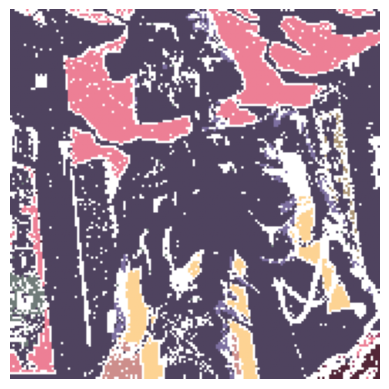

In [ ]:
img_cut_cls_median = colors_median.reshape((img_cut.shape))
draw_picture(img_cut_cls_median)

Для данных картинок видно, что немного различается коричневого (который составляет основную часть всех цветов на этих изображеный), а в остальном сильних различий не наблюдается.

## Перебор гиперпараметров для My_DBSCAN

In [ ]:
from collections import defaultdict


def grid_param_clalg(Clust_alg, X_: np.array, img_, params: dict, save_imgs=False):
    d_ssim = defaultdict(list)
    args1, args2 = params.values()
    arg1_name, arg2_name = params.keys()

    if save_imgs:
        d_imgs = np.zeros((len(args1), len(args2), 2, img_.shape[0], img_.shape[1], img_.shape[2]))

    for i, arg1 in enumerate(tqdm(args1, desc=arg1_name)):
        for j, arg2 in enumerate(tqdm(args2, desc=arg2_name)):
            kwargs = {arg1_name: arg1, arg2_name: arg2}

            clalg = Clust_alg(**kwargs).fit(X_)

            X_cut_and_labels = np.concatenate((X_, clalg.labels_.reshape(-1, 1)), axis=1)
            df_xl = pd.DataFrame(X_cut_and_labels, columns=['b', 'g', 'r', 'label'])
            cls_stats = df_xl.groupby('label').agg(['mean', 'median'])

            cc_mm = np.apply_along_axis(get_colors, 1, X_cut_and_labels[:,-1].reshape(-1, 1), cls_stats)

            colors_mean = cc_mm[:, 0]
            colors_median = cc_mm[:, 1]

            img_cut_cls_mean = colors_mean.reshape((img_.shape))
            img_cut_cls_median = colors_median.reshape((img_.shape))

            mean_ssim = structural_similarity(img_ / 255, img_cut_cls_mean, multichannel=True)
            median_ssim = structural_similarity(img_ / 255, img_cut_cls_median, multichannel=True)

            d_ssim[arg1_name].append(arg1)
            d_ssim[arg2_name].append(arg2)

            d_ssim['mean_ssim'].append(mean_ssim)
            d_ssim['median_ssim'].append(median_ssim)

            if save_imgs:
                # d_ssim['imgs_mean'].append(np.asarray(img_cut_cls_mean))
                # d_ssim['imgs_median'].append(np.array(img_cut_cls_median))

                d_imgs[i, j, 0, :, :, :] = img_cut_cls_mean
                d_imgs[i, j, 1, :, :, :] = img_cut_cls_median
                d_ssim['img_index_array'].append((i, j))

    if save_imgs:
        return pd.DataFrame(d_ssim), d_imgs

    return  pd.DataFrame(d_ssim)

На прогонку следующей ячейки ушло около 3х часов, поэтому для повторного запуска будем использовать данные полученные из этой ячейки ранее.

In [ ]:
epses = np.array([3, 5, 7, 10, 15, 20, 30, 50, 75])
m_ss = np.array([3, 5, 10, 20, 50, 75])
params = {'eps': epses, 'min_samples': m_ss}

# df_ssim_db, d_imgs_db = grid_param_clalg(My_DBSCAN, X_cut, img_cut, params, save_imgs=True)

In [ ]:
df_ssim = pd.read_csv('my_dbscan_all_ssim.csv')
d_imgs_db = np.load('d_imgs_db.npy')

In [ ]:
df_ssim.head()

# тут img_index_array - это пара индексов, по которым можно найти картинки в d_imgs_db,
# полученные для данных гиперпараметров с помощью mean/median.
# Первый индекс соответсвует первой оси, второй - второй оси.

,eps,min_samples,mean_ssim,median_ssim,img_index_array
0,3,3,0.252714,0.255953,"(0, 0)"
1,3,5,0.211284,0.214179,"(0, 1)"
2,3,10,0.256940,0.266356,"(0, 2)"
3,3,20,0.029144,0.029144,"(0, 3)"
4,3,50,0.037450,0.037450,"(0, 4)"


In [ ]:
d_imgs_db.shape

# поясню: d_imgs_db имеет размерность (9, 6, 2, 160, 160, 3),
# где первые две оси - для различных значений гиперпараметров,
# следующая для картинки, полученной с помошью mean/median соответственно,
# последние три для массива самой картинки

# Весь этот массив нужен только, чтобы дальше нарисовать некоторые из полученных картинок.

(9, 6, 2, 160, 160, 3)

In [ ]:
df_ssim[df_ssim['mean_ssim'] == max(df_ssim['mean_ssim'])]

,eps,min_samples,mean_ssim,median_ssim,img_index_array
23,10,75,0.295204,0.299609,"(3, 5)"


In [ ]:
df_ssim[df_ssim['median_ssim'] == max(df_ssim['median_ssim'])]

,eps,min_samples,mean_ssim,median_ssim,img_index_array
23,10,75,0.295204,0.299609,"(3, 5)"


Посмотрим на графикик значения метрики при разных гиперпараметрах.

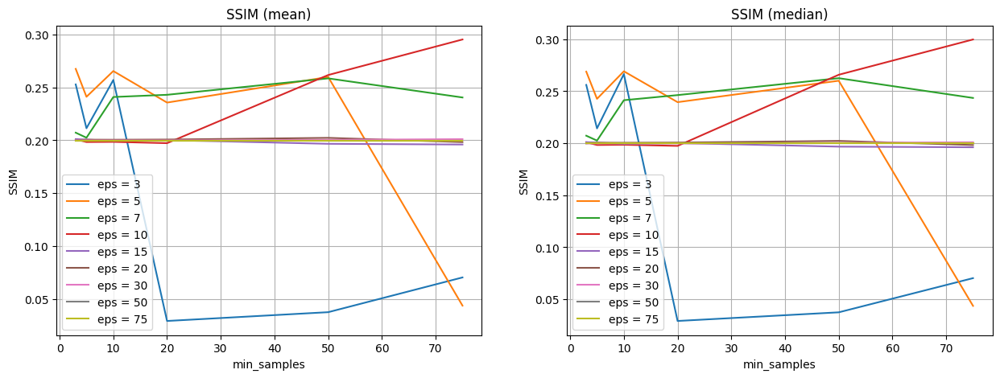

In [ ]:
#@title Графики для метрики SSIM.

plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
for eps in epses:
    data = df_ssim[df_ssim['eps'] == eps]
    plt.plot(data['min_samples'], data['mean_ssim'], label=f'eps = {eps}')

plt.xlabel('min_samples')
plt.ylabel('SSIM')
plt.title('SSIM (mean)')
plt.grid()
plt.legend()


plt.subplot(1, 2, 2)
for eps in epses:
    data = df_ssim[df_ssim['eps'] == eps]
    plt.plot(data['min_samples'], data['median_ssim'], label=f'eps = {eps}')

plt.xlabel('min_samples')
plt.ylabel('SSIM')
plt.title('SSIM (median)')
plt.grid()
plt.legend()

plt.show()

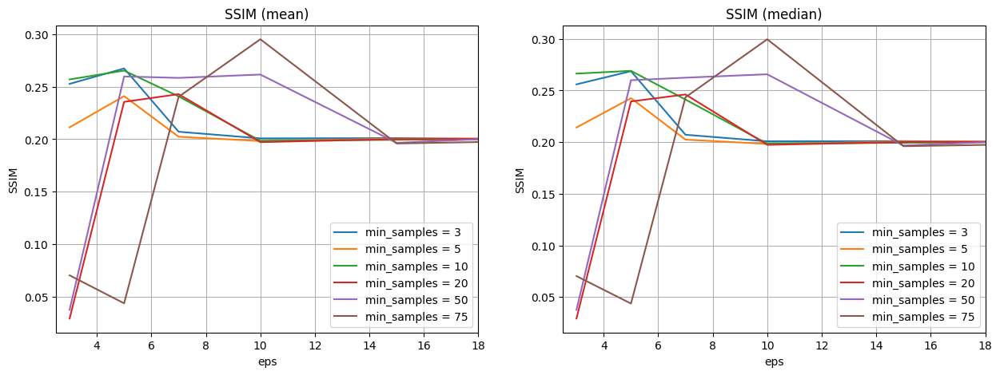

In [ ]:
#@title Графики для метрики SSIM.

plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
for m_s in m_ss:
    data = df_ssim[df_ssim['min_samples'] == m_s]
    plt.plot(data['eps'], data['mean_ssim'], label=f'min_samples = {m_s}')

# plt.xlim(2.5, 18)
plt.xlabel('eps')
plt.ylabel('SSIM')
plt.title('SSIM (mean)')
plt.grid()
plt.legend()


plt.subplot(1, 2, 2)
for m_s in m_ss:
    data = df_ssim[df_ssim['min_samples'] == m_s]
    plt.plot(data['eps'], data['median_ssim'], label=f'min_samples = {m_s}')

# plt.xlim(2.5, 18)
plt.xlabel('eps')
plt.ylabel('SSIM')
plt.title('SSIM (median)')
plt.grid()
plt.legend()

plt.show()

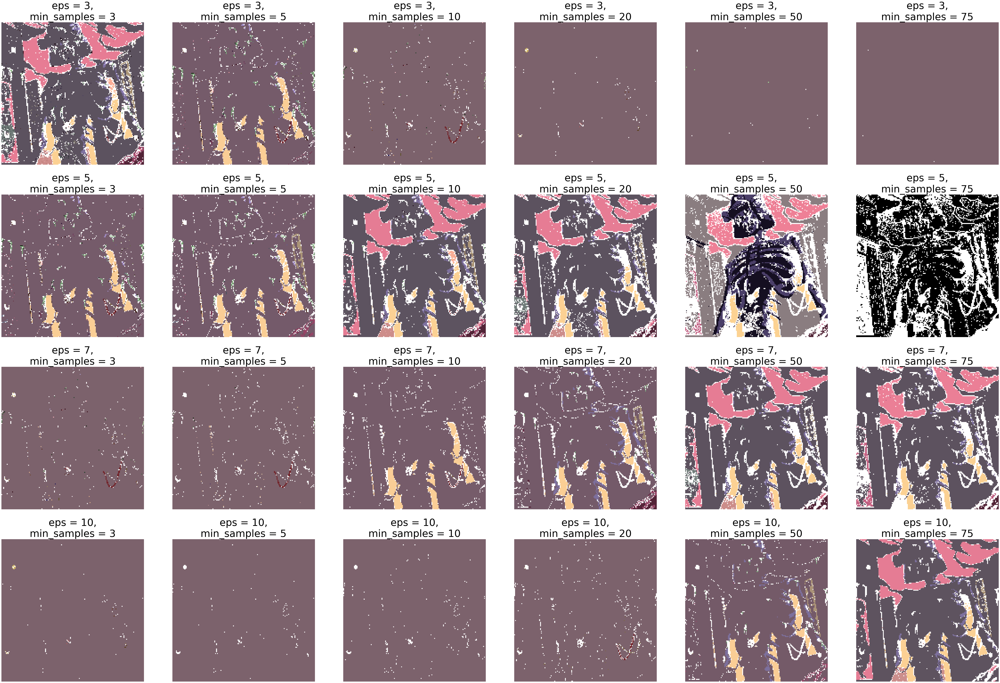

In [ ]:
#@title Для отрисовки некоторых картинок (mean):

fig = plt.figure(figsize=(90, 60))

# можно посмотреть на все получившиеся картинки, но я выбрал те, на которых видно хоть какой-то результат
for i, eps in enumerate(epses[[0, 1, 2, 3]]):
    for j, m_s in enumerate(m_ss):
        img_idxs = df_ssim[(df_ssim['eps'] == eps) & (df_ssim['min_samples'] == m_s)]['img_index_array'].values
        j_idx, i_idx = int(img_idxs[0][1]), int(img_idxs[0][-2])

        img_mean = d_imgs_db[i_idx, j_idx, 0]
        # img_median = d_imgs_db[i_idx, j_idx, 1]

        ax = fig.add_subplot(len(epses[[0, 1, 2, 3]]), len(m_ss), i * len(m_ss) + j + 1)
        draw_picture(img_mean)
        ax.set_title(f'eps = {eps},\nmin_samples = {m_s}', fontsize=50)

plt.show()

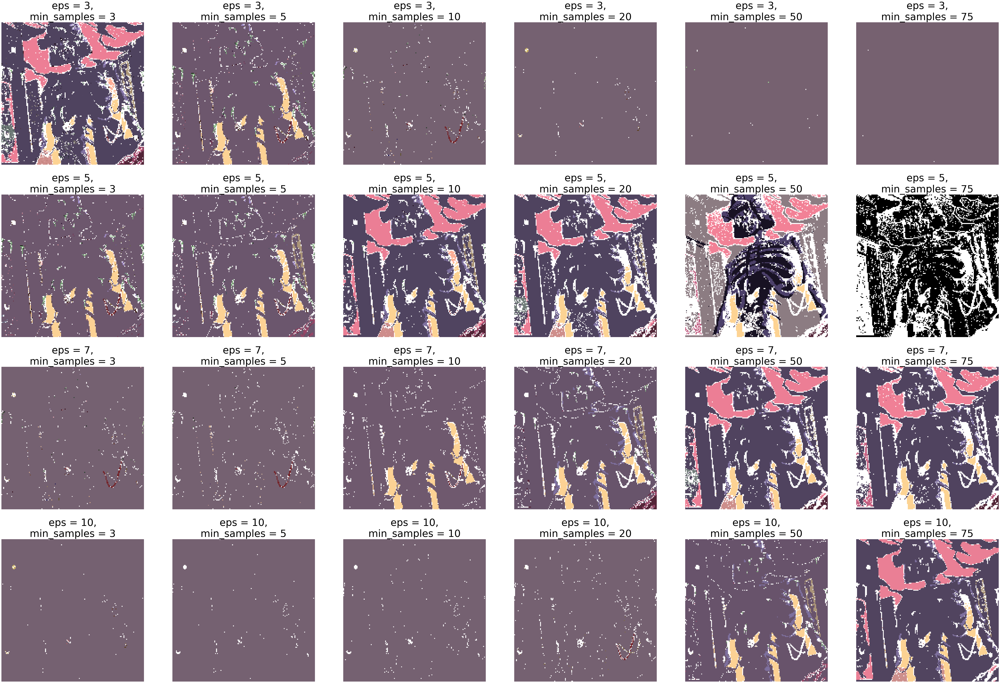

In [ ]:
#@title Для отрисовки некоторых картинок (median):

fig = plt.figure(figsize=(90, 60))

# аналогично и тут
for i, eps in enumerate(epses[[0, 1, 2, 3]]):
    for j, m_s in enumerate(m_ss):
        img_idxs = df_ssim[(df_ssim['eps'] == eps) & (df_ssim['min_samples'] == m_s)]['img_index_array'].values
        j_idx, i_idx = int(img_idxs[0][1]), int(img_idxs[0][-2])

        # img_mean = d_imgs_db[i_idx, j_idx, 0]
        img_median = d_imgs_db[i_idx, j_idx, 1]

        ax = fig.add_subplot(len(epses[[0, 1, 2, 3]]), len(m_ss), i * len(m_ss) + j + 1)
        draw_picture(img_median)
        ax.set_title(f'eps = {eps},\nmin_samples = {m_s}', fontsize=50)

plt.show()

Таким образом, хоть данный метод и хорош в кластеризации нелинейных данных, но в данном случае он абсолютноо не применим (что видно и по метрике и по графику пиксилей, так как данные на нем имеют линейную зависимость с сильным шумом). Поэтому для данной картинки лучше использовать метод KMeans, который хорошо себя показал на опытах из предыдущей секции.

## Перебор гиперпараметров для DBSCAN из sklearn

Понятно, что встроенный метод кластеризации DBSCAN должен быстрее справиться с обработкой данных, поэтому проведем аналогичные действия для него тоже.

In [ ]:
from sklearn.cluster import DBSCAN

epses = [3, 5, 7, 10, 15, 20, 30, 50, 75]
m_ss = [3, 5, 10, 20, 50, 75]
params = {'eps': epses, 'min_samples': m_ss}

# df2_ssim, d2_imgs = grid_param_clalg(DBSCAN, X_cut, img_cut, params, save_imgs=True)

In [ ]:
# df2_ssim.to_csv('all_ssim_from_skl.csv', index=False)
# np.save('d2_imgs.npy', d2_imgs)

In [ ]:
# ждать довольно долго, поэтому в следующий раз будем сразу использовать ранее полученные и скачанные данные

df2_ssim = pd.read_csv('all_ssim_from_skl.csv')
d2_imgs = np.load('d2_imgs.npy')

In [ ]:
df2_ssim.head()

,eps,min_samples,mean_ssim,median_ssim,img_index_array
0,3,3,0.265647,0.269086,"(0, 0)"
1,3,5,0.224382,0.227695,"(0, 1)"
2,3,10,0.169202,0.170995,"(0, 2)"
3,3,20,0.040524,0.040524,"(0, 3)"
4,3,50,0.022770,0.022770,"(0, 4)"


In [ ]:
df2_ssim[df2_ssim['mean_ssim'] == max(df2_ssim['mean_ssim'])]

,eps,min_samples,mean_ssim,median_ssim,img_index_array
23,10,75,0.295883,0.300339,"(3, 5)"


In [ ]:
df2_ssim[df2_ssim['median_ssim'] == max(df2_ssim['median_ssim'])]

,eps,min_samples,mean_ssim,median_ssim,img_index_array
23,10,75,0.295883,0.300339,"(3, 5)"


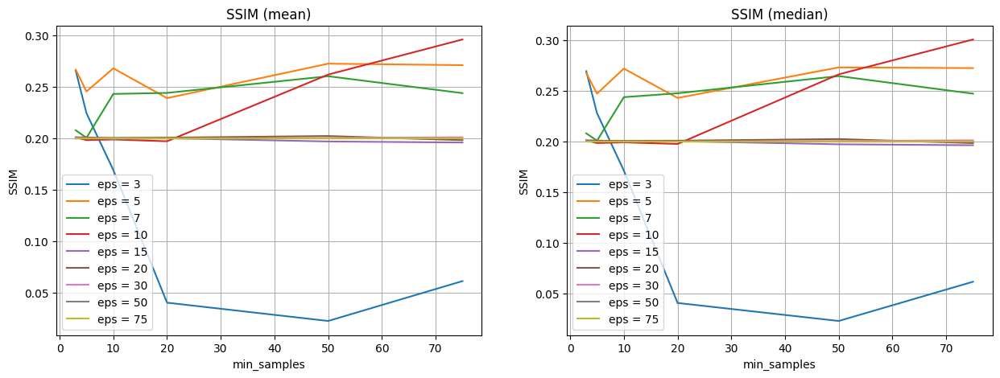

In [ ]:
#@title Графики для метрики SSIM.

plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
for eps in epses:
    data = df2_ssim[df2_ssim['eps'] == eps]
    plt.plot(data['min_samples'], data['mean_ssim'], label=f'eps = {eps}')

plt.xlabel('min_samples')
plt.ylabel('SSIM')
plt.title('SSIM (mean)')
plt.grid()
plt.legend()


plt.subplot(1, 2, 2)
for eps in epses:
    data = df2_ssim[df2_ssim['eps'] == eps]
    plt.plot(data['min_samples'], data['median_ssim'], label=f'eps = {eps}')

plt.xlabel('min_samples')
plt.ylabel('SSIM')
plt.title('SSIM (median)')
plt.grid()
plt.legend()

plt.show()

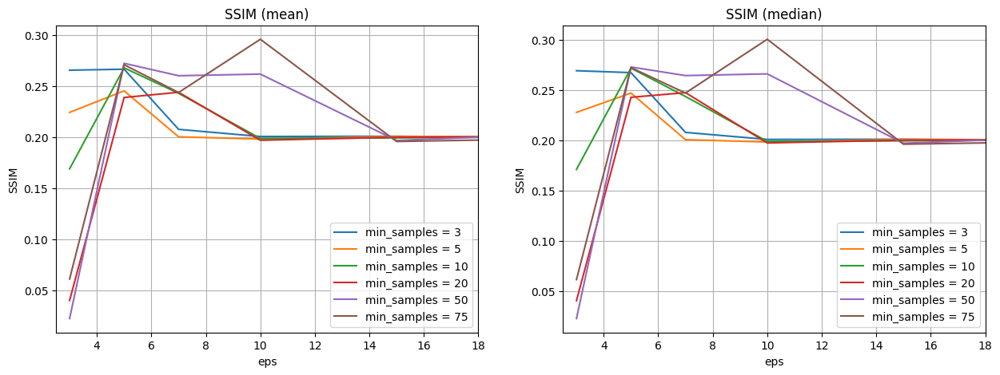

In [ ]:
#@title Графики для метрики SSIM.

plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
for m_s in m_ss:
    data = df2_ssim[df2_ssim['min_samples'] == m_s]
    plt.plot(data['eps'], data['mean_ssim'], label=f'min_samples = {m_s}')

plt.xlim(2.5, 18)
plt.xlabel('eps')
plt.ylabel('SSIM')
plt.title('SSIM (mean)')
plt.grid()
plt.legend()


plt.subplot(1, 2, 2)
for m_s in m_ss:
    data = df2_ssim[df2_ssim['min_samples'] == m_s]
    plt.plot(data['eps'], data['median_ssim'], label=f'min_samples = {m_s}')

plt.xlim(2.5, 18)
plt.xlabel('eps')
plt.ylabel('SSIM')
plt.title('SSIM (median)')
plt.grid()
plt.legend()

plt.show()

Как и ожидалось даже встроенный метод показал плохой результат на метрике SSIM, а значит вся "проблема" именно в структуре данных (то есть данный метод не применим для данной картинки, если мы хотим уменьшить палитру цветов, не сильно потеряв в качестве).

Потому что, мы не можем явно контролировать количество кластеров разбиения и из-за этого для слишком цветных картинок данный алгоритм не подходит (то есть, наглядным примером можед быть картинка с градиентом цветов: так как цвета меняются плавно, то выделить отдельные кластеры по этому алгоритму становится довольно сложно).

# 4 - AgglomerativeClustering

Данной секции не было, но в самом начале предлагалось также попробовать и этот алгоритм.

[link](https://habr.com/ru/companies/yandex/articles/503492/), [video](https://www.youtube.com/watch?v=XJ3194AmH40)

Так как данный алгоритм имеет сложность $O(n^2\ln n)$ по времени (даже с учетом различных ускорений) и $O(n^2)$ по памяти, то будем работать с той же ужатой картинкой.

In [ ]:
img2cut = img[::4, ::4]
img2cut.shape

(160, 160, 3)

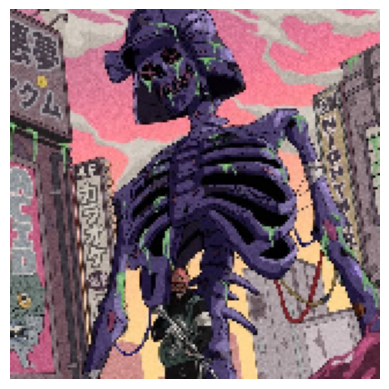

In [ ]:
draw_picture(img2cut)

In [ ]:
X2cut = img2cut.reshape((-1,3)).astype(np.float32)

## Пример работы алгоритма для `n_clusters = 25`, `affinity='euclidean', linkage='average'`

In [ ]:
from sklearn.cluster import AgglomerativeClustering

agc = AgglomerativeClustering(n_clusters=25, affinity='euclidean', linkage='average')
agc.fit(X2cut)

AgglomerativeClustering(affinity='euclidean', linkage='average', n_clusters=25)

In [ ]:
X2cut_and_labels = np.concatenate((X2cut, agc.labels_.reshape(-1, 1)), axis=1)

In [ ]:
df_xl = pd.DataFrame(X2cut_and_labels, columns=['b', 'g', 'r', 'label'])
cls_stats = df_xl.groupby('label').agg(['mean', 'median'])
cls_stats.head(5)

b                  g                  r       
             mean median        mean median        mean median
label                                                         
0.0    110.812500  110.5  174.750000  174.0  206.937500  208.0
1.0     44.322835   45.0   51.000000   46.0  109.937008  112.0
2.0    130.859675  132.0  101.212703  102.0  189.423929  191.0
3.0    122.824561  123.0  160.935673  161.0  124.979532  125.0
4.0     98.673581   99.0   73.692501   71.0   88.757693   85.0

In [ ]:
#@title The 3D interactive graph: Цветовая палитра кластеров (для средних)
# Try to plot the dots from matrix X, where
# the third column is the flatten r vector (component R of RGB image),
# the second - g, the first one - b; so the demension of our space is equal 3 (features)

# TODO:  Paint clusters in colors of theirs mean/median values
# for this: https://stackoverflow.com/questions/52788407/how-to-plot-graphics-with-the-colors-of-each-pixel-in-the-image


import plotly.graph_objs as go
import numpy as np

# n=10000

#@markdown ### Количество случайных пикселей, взятых из шакального изображения для отрисовки на графике (должно быть меньше `X2cut.shape`)
n = 10000 #@param {type:"integer"}
if n > X2cut.shape[0]:
    raise ValueError('n should be less than X2cut.shape[0]\n Ну я же просил...')

# Take some random dots data from X
A = X2cut_and_labels[np.random.randint(X2cut_and_labels.shape[0], size=n), :]
x = A[:, 0]
y = A[:, 1]
z = A[:, 2]

cc_mm = np.apply_along_axis(get_colors, 1, A[:,-1].reshape(-1, 1), cls_stats)
colors_mean = cc_mm[:, 0][:, [2, 1, 0]]
colors_median = cc_mm[:, 1][:, [2, 1, 0]]


# Create a trace for the scatter plot
trace1 = go.Scatter3d(x=x, y=y, z=z, mode='markers', marker=dict(size=5, color=colors_mean))

# Create a layout for the plot
layout = go.Layout(scene=dict(xaxis=dict(title='R component'),
                               yaxis=dict(title='G component'),
                               zaxis=dict(title='B component')))

# Combine the trace and layout into a figure
fig = go.Figure(data=[trace1], layout=layout)

# Display the plot
fig.show()


In [ ]:
cc_mm = np.apply_along_axis(get_colors, 1, X2cut_and_labels[:,-1].reshape(-1, 1), cls_stats)
colors_mean = cc_mm[:, 0]
colors_median = cc_mm[:, 1]

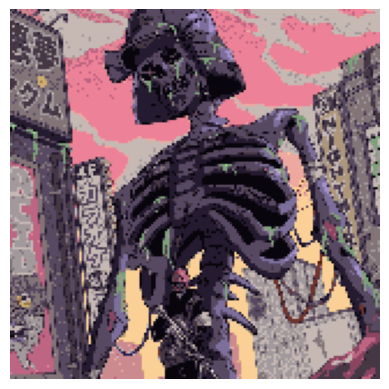

In [ ]:
img2cut_cls_mean = colors_mean.reshape((img2cut.shape))
draw_picture(img2cut_cls_mean)

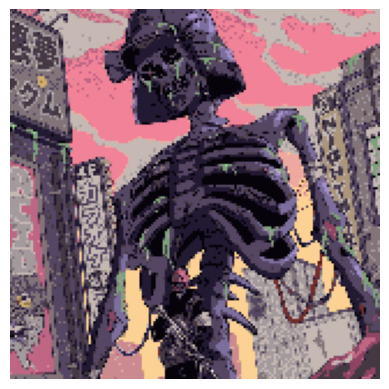

In [ ]:
img2cut_cls_median = colors_median.reshape((img2cut.shape))
draw_picture(img2cut_cls_median)

## Перебор гиперпараметров для AgglomerativeClustering из sklearn

А теперь посмотрим на метрику, перебирая различные значения гиперпараметров данного алгоритма:

In [ ]:
n_clss = [2, 3, 5, 10, 20, 50, 100, 1000, 5000, 10000]
linkages = ['ward', 'complete', 'average', 'single']

params = {'n_clusters': n_clss, 'linkage': linkages}

# df3_ssim, d_imgs = grid_param_clalg(AgglomerativeClustering, X2cut, img2cut, params, save_imgs=True)

In [ ]:
# df3_ssim.to_csv('aggl_cls_ssim.csv', index=False)
# np.save('d_imgs.npy', d_imgs)

In [ ]:
df3_ssim = pd.read_csv('aggl_cls_ssim.csv')
df3_ssim.head(5)

,n_clusters,linkage,mean_ssim,median_ssim,img_index_array
0,2,ward,0.652491,0.649767,"(0, 0)"
1,2,complete,0.652364,0.649670,"(0, 1)"
2,2,average,0.658041,0.655290,"(0, 2)"
3,2,single,0.200274,0.200172,"(0, 3)"
4,3,ward,0.803041,0.801618,"(1, 0)"


In [ ]:
df3_ssim[df3_ssim['mean_ssim'] == max(df3_ssim['mean_ssim'])]

,n_clusters,linkage,mean_ssim,median_ssim,img_index_array
36,10000,ward,0.999907,0.999889,"(9, 0)"


In [ ]:
df3_ssim[df3_ssim['median_ssim'] == max(df3_ssim['median_ssim'])]

,n_clusters,linkage,mean_ssim,median_ssim,img_index_array
36,10000,ward,0.999907,0.999889,"(9, 0)"


Что и следовало ожидать, так как данный алгоритм работает по принципу склейки двух 'близких' кластеров, то чем больше их будет тем точнее результат.

Ниже отрисуем нексколько картинок для разных значений гиперпараметров и построим график метрики SSIM в зависимости от их значений.

In [ ]:
d_imgs = np.load('d_imgs.npy')
d_imgs.shape

# Пояснения:
# Первые две размерности для каждого аргумента гиперпараметра,
# третья для картинки полученной через mean или median соответственно,
# остальные три - это классический массив картинки.
# Обращение к картинке происходит по паре индексов, указанных img_index_array в df3_ssim,
# с соответсвующими значениями гиперпараметров.

(10, 4, 2, 160, 160, 3)

In [ ]:
#@title Для отрисовки некоторых картинок (mean):

fig = plt.figure(figsize=(90, 125))

for i, linkage in enumerate(linkages):
    for j, n_clusters in enumerate(n_clss[::3]):
        img_idxs = df3_ssim[(df3_ssim['n_clusters'] == n_clusters) & (df3_ssim['linkage'] == linkage)]['img_index_array'].values
        j_idx, i_idx = int(img_idxs[0][1]), int(img_idxs[0][-2])

        img_mean = d_imgs[j_idx, i_idx, 0]
        # img_median = d_imgs[j_idx, img_idxs, 1]

        ax = fig.add_subplot(len(linkages), len(n_clss[::3]), i * len(n_clss[::3]) + j + 1)
        draw_picture(img_mean)
        ax.set_title(f'n_clusters={n_clusters},\nlinkage={linkage}', fontsize=100)

plt.show()

In [ ]:
#@title Для отрисовки некоторых картинок (median):

fig = plt.figure(figsize=(90, 125))

for i, linkage in enumerate(linkages):
    for j, n_clusters in enumerate(n_clss[::3]):
        img_idxs = df3_ssim[(df3_ssim['n_clusters'] == n_clusters) & (df3_ssim['linkage'] == linkage)]['img_index_array'].values
        j_idx, i_idx = int(img_idxs[0][1]), int(img_idxs[0][-2])

        # img_mean = d_imgs[j_idx, i_idx, 0]
        img_median = d_imgs[j_idx, img_idxs, 1]

        ax = fig.add_subplot(len(linkages), len(n_clss[::3]), i * len(n_clss[::3]) + j + 1)
        draw_picture(img_median)
        ax.set_title(f'n_clusters={n_clusters},\nlinkage={linkage}', fontsize=100)

plt.show()

Теперь посмотрим на графики для метрки SSIM в зависимости от значений гиперпараметров.

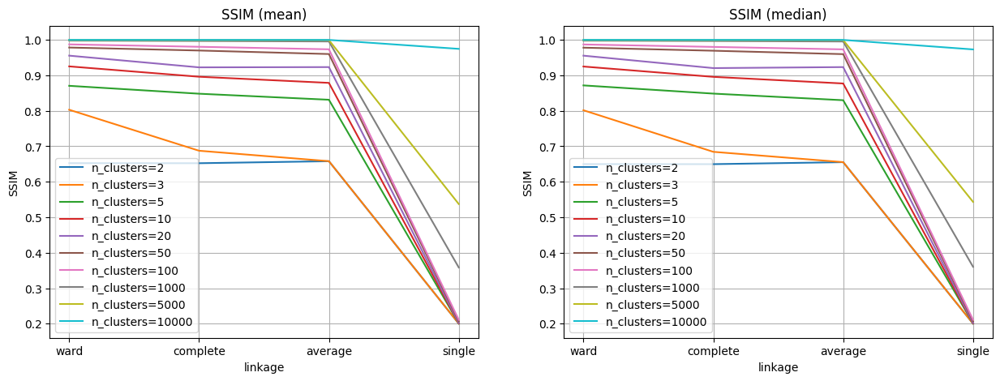

In [ ]:
#@title Графики для метрики SSIM.

plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
for n_clusters in n_clss:
    data = df3_ssim[df3_ssim['n_clusters'] == n_clusters]
    plt.plot(data['linkage'], data['mean_ssim'], label=f'{n_clusters=}')

plt.xlabel('linkage')
plt.ylabel('SSIM')
plt.title('SSIM (mean)')
plt.grid()
plt.legend()


plt.subplot(1, 2, 2)
for n_clusters in n_clss:
    data = df3_ssim[df3_ssim['n_clusters'] == n_clusters]
    plt.plot(data['linkage'], data['median_ssim'], label=f'{n_clusters=}')

plt.xlabel('linkage')
plt.ylabel('SSIM')
plt.title('SSIM (median)')
plt.grid()
plt.legend()

plt.show()

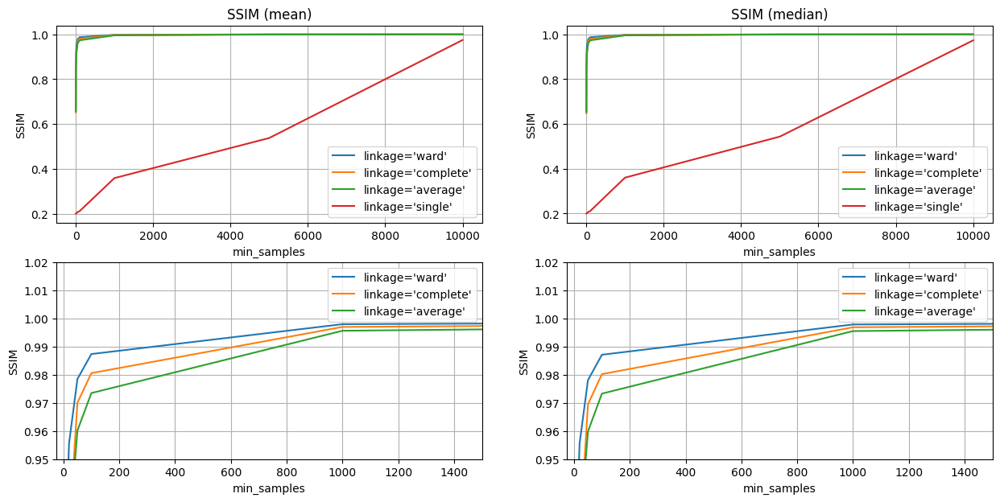

In [ ]:
#@title Графики для метрики SSIM.
fig, ax = plt.subplots(2, 2, figsize=(15, 7))

# plt.subplot(1, 2, 1)
for linkage in linkages:
    data = df3_ssim[df3_ssim['linkage'] == linkage]
    ax[0][0].plot(data['n_clusters'], data['mean_ssim'], label=f'{linkage=}')

    ax[0][0].set_xlabel('min_samples')
    ax[0][0].set_ylabel('SSIM')
    ax[0][0].set_title('SSIM (mean)')
    ax[0][0].grid(True)
    ax[0][0].legend()

for linkage in linkages[:-1]:
    data = df3_ssim[df3_ssim['linkage'] == linkage]
    ax[1][0].plot(data['n_clusters'], data['mean_ssim'], label=f'{linkage=}')
    ax[1][0].set_ylim(0.95, 1.02)
    ax[1][0].set_xlim(-25, 1500)

    ax[1][0].set_xlabel('min_samples')
    ax[1][0].set_ylabel('SSIM')
    # ax[1][0].set_title('SSIM (mean)')
    ax[1][0].grid(True)
    ax[1][0].legend()

for linkage in linkages:
    data = df3_ssim[df3_ssim['linkage'] == linkage]
    ax[0][1].plot(data['n_clusters'], data['median_ssim'], label=f'{linkage=}')

    ax[0][1].set_xlabel('min_samples')
    ax[0][1].set_ylabel('SSIM')
    ax[0][1].set_title('SSIM (median)')
    ax[0][1].grid(True)
    ax[0][1].legend()

for linkage in linkages[:-1]:
    data = df3_ssim[df3_ssim['linkage'] == linkage]

    ax[1][1].plot(data['n_clusters'], data['median_ssim'], label=f'{linkage=}')
    ax[1][1].set_ylim(0.95, 1.02)
    ax[1][1].set_xlim(-25, 1500)

    ax[1][1].set_xlabel('min_samples')
    ax[1][1].set_ylabel('SSIM')
    # ax[1][1].set_title('SSIM (median)')
    ax[1][1].grid(True)
    ax[1][1].legend()

plt.show()

И так, получается, что данный алгоритм тоже хорошо справляется с уменьшением палитры изображения (см. графики выше); например при количестве кластеров больше 50 почти у всех (кроме linkage=single), SSIM > 0.97.

Но данный метод имеет существенные недостатки, такие как скорость обучения и количество памяти, что делает его не самым оптимальным (для данной работы с изображением) по сравнению с KMeans, Но это если мы хотим, сильно сократить размер палитры.

# Вывод

В зависимости от того на сколько сильно мы хотим сократить палитру цветов, будет зависеть какой алгоритм предпочтительнее по соотношению "время работы - качество на метрике SSIM". Если хотим оставить много цветов, то лучше AgglomerativeClustering, если наоборот, то лучше KMeans. DВSCAN именно для данной картинки показал наихудший результат.